In [ ]:
#@title
%%HTML
<span style="font-family:Avenir; color:blue; font-size:5em;">Grid Search Algorithms</span>

##<font color='navy'> Motivation
<font color='crimson'>Why we need "grid search" algorithms?</font>

We may consider the fact that almost all models in Machine Learning require specific hyperparameters:

<figure>
<center>
<img src='https://drive.google.com/uc?id=1ZJkCH0O7fhHwdQFPw1tqsvpXpnakHEHC'
width='500px' />
<figcaption>Example</figcaption></center>
</figure>

<font color='red' size=4pt>**CRITICAL THINKING**: Why aren't we testing all possible choices/values for the hyperparameters?</font>

<font color='red' size=4pt> **CRITICAL THINKING**: Why not just use gradient descent to determine the best choice of hyperparameters? </font>

<font color='blue' size=4pt>IMPORTANT: We may rarely be able to compute gradients of the prediction error with respect to the *hyper*parameters.</font>

Also, in general, we deal with a problem of non-convex optimization and just finding a local minima is not good enough; also cannot easily compute the direction (gradient) for improving the hyperparameters that we try to optimize.

<font color='green' size = 4pt>**SOLUTION**:



*   Subdivide the ranges of hyperparameters in grids (if they are numerical, eaqually spaced values)
*   Initialize the hyperparameters with a random choice
*   Evaluate the prediction error with this choice
*   Update the hyperparameters with a *procedure* that includes *good heuristics*
*   Test the new choice
*   Repeat the previously two steps until there is no more distinguishable progress relative to a tolerance value. </font>




We can use algorithms that do not require the gradient of the objective function in order to estimate the value for the *hyperparameters* and thus complete the *model selection* process.

A *Grid Search* will involve subdividing the range of the hyperparameters by using small increments and then the grid search algorithm is choosing the value of the parameters from a finite set of choices within the range.

The simplest *grid search algorithm* is an exhaustive search, namely loop through all the candidates and pick the one that is the *best* according to predefined criteria, such as minimizing the k-fold cross-validated loss or maximizing the accuracy, etc.

<span style="font-family:Calibri; color:DodgerBlue; font-size:14pt;">Important:</span> In practice we cannot search all the points in a multi-dimensional grid, it is computationally too expensive. We need a strategy that efficiently approximates the solution.

**Example**: Assume that we want to determine the best tree depth *and* the best leaf size for a classification tree. The following image color-codes the values of the cost function based on the grid values.

<figure>
<center>
<img src='https://drive.google.com/uc?id=1EVr1hhK44KMTgke8U8feyfSm2mtA27uy'
width='500px' />
<figcaption>Example of a Grid</figcaption></center>
</figure>

<span style="font-family:Calibri; color:DeepPink; font-size:14pt;">Critical Thinking Question:</span> If we compute the cost function at some random point on the grid how do we know in what direction we can continue to search for improving (lowering) the value of the cost function?

<figure>
<center>
<img src='https://drive.google.com/uc?id=1jtywm9tz-eZWevgGo1RWQ9PM15EOnb3K'
width='500px' />
<figcaption>Example of a Grid</figcaption></center>
</figure>



##<font color='navy'> Genetic Algorithms

<figure>
<center>
<img src='https://drive.google.com/uc?id=1oc1UMJRcwAOAF2vexna7hlTmaMlNwMh_'
width='400px' />
<figcaption>Genetic Algorithm</figcaption></center>
</figure>

### **Evaluation**

We compute the value of the ouput at each individual form the population and we ranked the individuals.

### **Selection**

In order to create a parent we draw a random subset from the population and pick the most "fit" individual. Once we obtain two parents we can applying the *crossover* and *mutation* procedures for generating children.

### **Crossover**

Typically we implement a two-point crossover. If the grid is 2-D we consider a crossover procedure illustrated below:

<figure>
<center>
<img src='https://drive.google.com/uc?id=1PFG_GnavxIdJeCe-iDTlWv-RluHxHepo'
width='400px' />
<figcaption>Two-point crossover in 2-D</figcaption></center>
</figure>

In 3-D a two-point crossover can be implemented as follows:

<figure>
<center>
<img src='https://drive.google.com/uc?id=1GmazeR1zWMVlNPgG4q73rWoFErobf8bF'
width='400px' />
<figcaption>Two-point crossover in 3-D</figcaption></center>
</figure>


### **Mutation**

We implement the mutation as a perturbation with values sampled from a random normal variable of mean 0 and standard deviation equal to the desired "mutation scale."

Example for the mutation function:

```Python
def mutate(child, mutation_rate, mutation_scale):
    "May mutate a child using Gaussian convolution"
    if mutation_rate >= random.uniform(0, 1):
        size = child.shape[0]
        mutation_value = np.random.normal(0, mutation_scale, size)
        child = child + mutation_value
    return child
```

### **Example of Visualization**

<figure>
<center>
<img src='https://drive.google.com/uc?id=1faLEaop7OFfeiw-coovR6vt7nY6qBuS6'
width='1000px' />
<figcaption>Two-point crossover in 3-D</figcaption></center>
</figure>




<font size=4pt> References:

*   http://cobweb.cs.uga.edu/~potter/CompIntell/ga_tutorial.pdf

*   https://www.scottcondron.com/jupyter/optimisation/visualisation/2020/07/20/interactive-genetic-algorithm-dashboard-from-scratch-in-python.html

*   https://mitpress.mit.edu/9780262631853/an-introduction-to-genetic-algorithms/


Fun video to watch:

https://www.youtube.com/watch?v=FKbarpAlBkw





##<font color='navy' size=6pt> Swarm Algorithms - Particle Swarm Optimization</font>

Main Idea: consider a collection of particles that move around the search space influenced by their own best past location and the best past location of the whole swarm or a close neighbor.

<figure>
<center>
<img src='https://drive.google.com/uc?id=1dZibCB20kaKcqpQQ2v2JCLERzXTlWNuO'
width='500px' />
<figcaption>Example of a Function by Arrow Diagram</figcaption></center>
</figure>


$$\large v_i (t+1)=w\cdot v_i (t)+c_1⋅\chi⋅(p_i^{\text{best}} (t)−p_i (t))+c_2⋅\chi⋅(p^{\text{gbest}} (t)−p_i (t))$$

where $$\large \chi \sim \text{Unif}(0,1)$$ and $c_1$ and $c_2$ are constants.

The particle positions get updated: $$\large p_{i} (t+1)=p_i  (t)+v_i (t)$$

**Heuristics**

  - The number of particles should be low, around 20-40

  - The speed a particle can move (maximum change in its position per iteration) should be bounded, such as to a percentage of the size of the domain.

  - The learning factors (biases towards global and personal best positions) should be between 0 and 4, typically 2.

  - A local bias (local neighborhood) factor can be introduced where neighbors are determined based on Euclidean distance between particle positions.

  - Particles may leave the boundary of the problem space and may be penalized, be reflected back into the domain or biased to return back toward a position in the problem domain. Alternatively, a wrapping strategy may be used at the edge of the domain creating a loop, torrid or related geometrical structures at the chosen dimensionality.

An inertia or momentum coefficient can be introduced to limit the change in velocity.




##<font color='navy'> Example of Particle Swarm Optimization

### A 2D Animation

In [ ]:
!pip install -q pyswarms

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.1/104.1 kB 3.0 MB/s eta 0:00:00


In [ ]:
# Import modules
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Image

# Import PySwarms
import pyswarms as ps
from pyswarms.utils.functions import single_obj as fx
from pyswarms.utils.plotters import (plot_cost_history, plot_contour, plot_surface)

In [ ]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [ ]:
options = {'c1':0.24, 'c2':0.03, 'w':0.77}
optimizer = ps.single.GlobalBestPSO(n_particles=20, dimensions=2, options=options)
cost, pos = optimizer.optimize(fx.sphere, iters=100)

2022-10-27 14:18:15,778 - pyswarms.single.global_best - INFO - Optimize for 100 iters with {'c1': 0.24, 'c2': 0.03, 'w': 0.77}
pyswarms.single.global_best: 100%|██████████|100/100, best_cost=1.29e-11
2022-10-27 14:18:16,023 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 1.2942377370735998e-11, best pos: [-3.47424432e-06  9.33811412e-07]


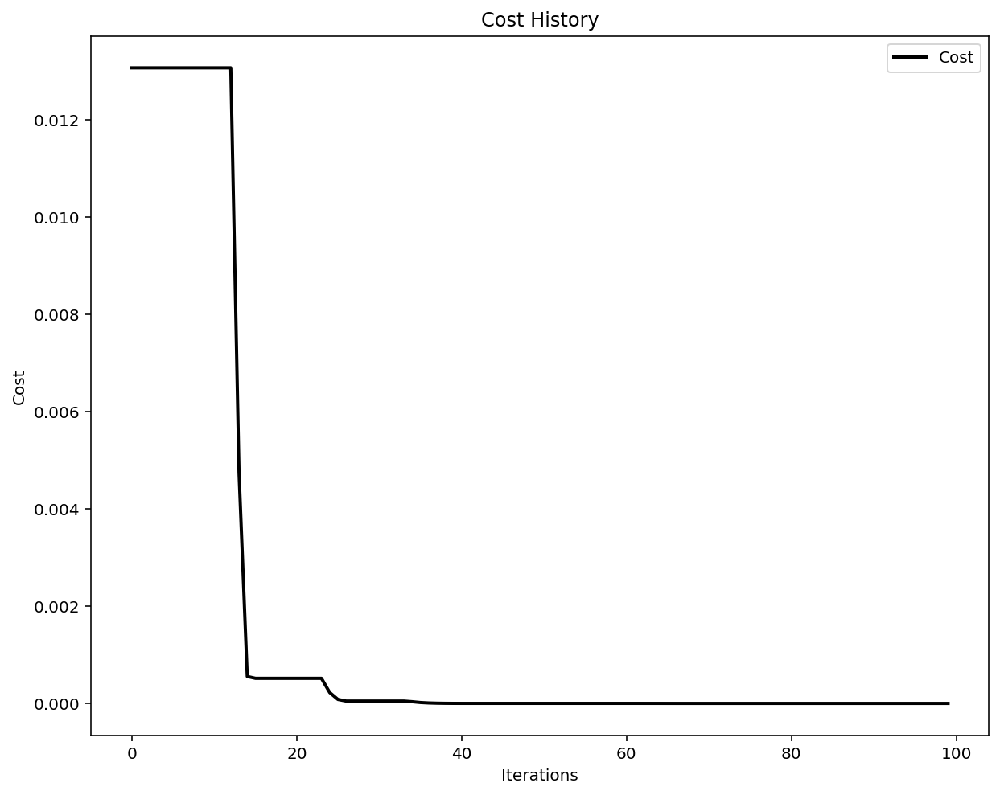

In [ ]:
plot_cost_history(cost_history=optimizer.cost_history)
plt.show()

In [ ]:
from pyswarms.utils.plotters.formatters import Mesher

In [ ]:
# Initialize mesher with sphere function
m = Mesher(func=fx.sphere)

In [ ]:
%%capture
# Make animation
animation = plot_contour(pos_history=optimizer.pos_history,mesher=m,mark=(0,0))

2022-10-27 14:19:07,092 - matplotlib.animation - INFO - Animation.save using <class 'matplotlib.animation.PillowWriter'>


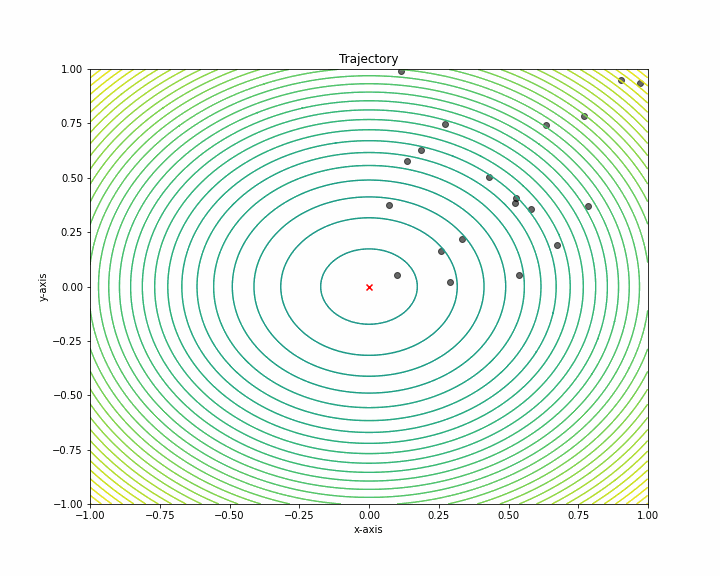

In [ ]:
# Enables us to view it in a Jupyter notebook
animation.save('result2D.gif', writer='pillow', fps=10)
Image(open('result2D.gif','rb').read())

### A 3D Animation

In [ ]:
# Obtain a position-fitness matrix using the Mesher.compute_history_3d()
# method. It requires a cost history obtainable from the optimizer class
pos_history_3d = m.compute_history_3d(optimizer.pos_history)

In [ ]:
# Make a designer and set the x,y,z limits to (-1,1), (-1,1) and (-0.1,1) respectively
from pyswarms.utils.plotters.formatters import Designer
d = Designer(limits=[(-1,1), (-1,1), (-0.1,1)], label=['x-axis', 'y-axis', 'z-axis'])

In [ ]:
%%capture
# Make animation
animation3d = plot_surface(pos_history=pos_history_3d, # Use the cost_history we computed
                           mesher=m, designer=d,       # Customizations
                           mark=(0,0,0))

2022-03-30 12:27:39,093 - matplotlib.animation - INFO - Animation.save using <class 'matplotlib.animation.PillowWriter'>


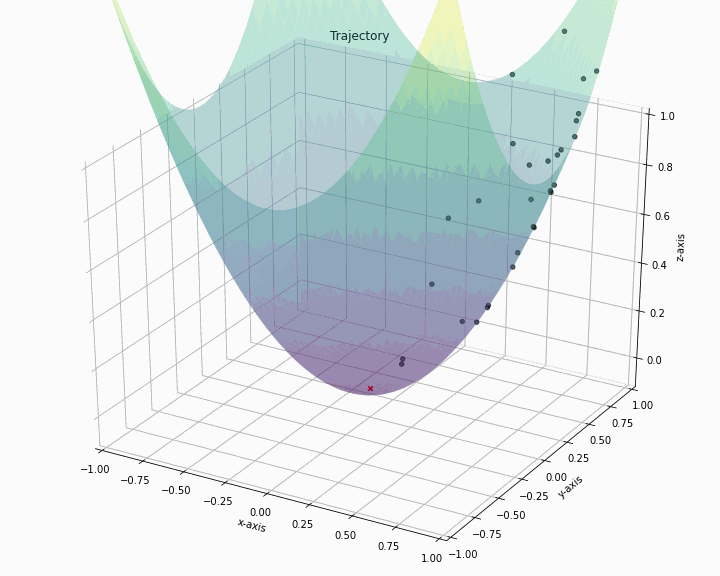

In [ ]:
animation3d.save('result3D.gif', writer='pillow', fps=10)
Image(open('result3D.gif','rb').read())

##<font color='navy' size=6pt> Simulated Annealing</font>

**Main Idea**: drop a random trial point and then, based on the value of the objective function, continue to drop other points at a certain distance. The distance between consecutive points is measured as a function of the "temperature" which is decreasing based on an exponential law.

**Important** This method use only one point at a time. The temperature of the grid is deacreasing, such as $T_{i+1}=rT_{i}$ where $0<r<1.$ The probability that the system will transition from state $e_i$ to state $e_{i+1}$ is

$$\text{P}(e_{i+1}\text{at temperature } T_i)=\begin{cases} e^{-(\text{New Loss} - \text{Loss})/T_i} &\text{if}& \text{New Loss}\, > \,\text{Loss}\\
1 &\text{if}& \text{New Loss}\, \leq \,\text{Loss}\end{cases} $$

Decision to continue: if
$$ \text{P}(e_{i+1}\text{at temperature } T_i)>\chi\,\, \text{where}\,\, \chi \sim \text{Unif}(0,1).$$

Formal steps:

- Let $s=s_0$ where $s_0$ is a random guess.
- An iterator $k$ is decreasing from $k_{max}$ to $0.$
- Set $T←\text{temperature}((k+1)/k_{max})$
- Pick a random neighbor, $s_{new}←\text{neighbor}(s)$
- If $\text{P}(s_{new},T)>\text{random}(0,1)$ then $s→s_{new}$
Output: the final state $s$



Visual example for simulated annealing algorithm: https://www.youtube.com/watch?v=iaq_Fpr4KZc

##<font color='navy' size = 6pt> Example with GridsearchCV and Simulated Annealing

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline, make_pipeline
plt.rc('font', size=16)
plt.rc('axes', titlesize=16)

In [ ]:
data = pd.read_csv('drive/MyDrive/Data Sets/housing.csv')

In [ ]:
data

,town,tract,longitude,latitude,crime,residential,industrial,river,nox,rooms,older,distance,highway,tax,ptratio,lstat,cmedv
0,Nahant,2011,-70.955002,42.255001,0.00632,18.0,2.31,no,0.538,6.575,65.199997,4.0900,1,296,15.300000,4.98,24.000000
1,Swampscott,2021,-70.949997,42.287498,0.02731,0.0,7.07,no,0.469,6.421,78.900002,4.9671,2,242,17.799999,9.14,21.600000
2,Swampscott,2022,-70.935997,42.283001,0.02729,0.0,7.07,no,0.469,7.185,61.099998,4.9671,2,242,17.799999,4.03,34.700001
3,Marblehead,2031,-70.928001,42.292999,0.03237,0.0,2.18,no,0.458,6.998,45.799999,6.0622,3,222,18.700001,2.94,33.400002
4,Marblehead,2032,-70.921997,42.298000,0.06905,0.0,2.18,no,0.458,7.147,54.200001,6.0622,3,222,18.700001,5.33,36.200001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,Winthrop,1801,-70.986000,42.231201,0.06263,0.0,11.93,no,0.573,6.593,69.099998,2.4786,1,273,21.000000,9.67,22.400000
502,Winthrop,1802,-70.990997,42.227501,0.04527,0.0,11.93,no,0.573,6.120,76.699997,2.2875,1,273,21.000000,9.08,20.600000
503,Winthrop,1803,-70.994797,42.226002,0.06076,0.0,11.93,no,0.573,6.976,91.000000,2.1675,1,273,21.000000,5.64,23.900000
504,Winthrop,1804,-70.987503,42.223999,0.10959,0.0,11.93,no,0.573,6.794,89.300003,2.3889,1,273,21.000000,6.48,22.000000


In [ ]:
data.drop('river',axis=1)

,town,tract,longitude,latitude,crime,residential,industrial,nox,rooms,older,distance,highway,tax,ptratio,lstat,cmedv
0,Nahant,2011,-70.955002,42.255001,0.00632,18.0,2.31,0.538,6.575,65.199997,4.0900,1,296,15.300000,4.98,24.000000
1,Swampscott,2021,-70.949997,42.287498,0.02731,0.0,7.07,0.469,6.421,78.900002,4.9671,2,242,17.799999,9.14,21.600000
2,Swampscott,2022,-70.935997,42.283001,0.02729,0.0,7.07,0.469,7.185,61.099998,4.9671,2,242,17.799999,4.03,34.700001
3,Marblehead,2031,-70.928001,42.292999,0.03237,0.0,2.18,0.458,6.998,45.799999,6.0622,3,222,18.700001,2.94,33.400002
4,Marblehead,2032,-70.921997,42.298000,0.06905,0.0,2.18,0.458,7.147,54.200001,6.0622,3,222,18.700001,5.33,36.200001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,Winthrop,1801,-70.986000,42.231201,0.06263,0.0,11.93,0.573,6.593,69.099998,2.4786,1,273,21.000000,9.67,22.400000
502,Winthrop,1802,-70.990997,42.227501,0.04527,0.0,11.93,0.573,6.120,76.699997,2.2875,1,273,21.000000,9.08,20.600000
503,Winthrop,1803,-70.994797,42.226002,0.06076,0.0,11.93,0.573,6.976,91.000000,2.1675,1,273,21.000000,5.64,23.900000
504,Winthrop,1804,-70.987503,42.223999,0.10959,0.0,11.93,0.573,6.794,89.300003,2.3889,1,273,21.000000,6.48,22.000000


In [ ]:
x = data.drop('river',axis=1).loc[:,'crime':'lstat'].values
y = data['cmedv'].values

In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
mypipe = Pipeline(steps=[('scale',StandardScaler()),('lasso',Lasso(max_iter=10000))])

In [ ]:
%%time
params = {'lasso__alpha':np.linspace(0.001,2,num=4000)}
gs = GridSearchCV(estimator=mypipe,cv=10,scoring='neg_mean_squared_error',param_grid=params)
gs_results = gs.fit(x,y)
print(gs_results.best_params_)
print('The external validity is: ', np.abs(gs_results.best_score_))

{'lasso__alpha': 0.0949764941235309}
The external validity is:  33.474901655901235
CPU times: user 1min 48s, sys: 301 ms, total: 1min 49s
Wall time: 1min 54s


In [ ]:
%%time
model = ElasticNet(max_iter=10000)
params = [{'alpha':np.linspace(0.001,2,num=1000),'l1_ratio':np.linspace(0.001,1,num=1000)}]
gs = GridSearchCV(estimator=model,cv=10,scoring='neg_mean_squared_error',param_grid=params)
gs_results = gs.fit(x,y)
print(gs_results.best_params_)
print('The mean square error is: ', np.abs(gs_results.best_score_))

In [ ]:
print(gs_results.best_params_)
print('The mean square error is: ', np.abs(gs_results.best_score_))

{'alpha': 1.0, 'l1_ratio': 0.0}
The mean square error is:  64.57677655644844


In [ ]:
gs_results

## Here we present a detailed implementation of Simulated Annealing in 1D

ATTENTION: The following example of simulated annealing only works if you have one hyperparameter. If you have two or more you would have to implement sensible changes to make it work.

In [1]:
# Here we have a simple implementation of Simmulated Annealing in One Dimension
MIN_ALPHA = 0.0001
MAX_ALPHA = 2
STEP_SIZE = 1     # Std of gaussian steps
COOLING = 0.98    # T_{n+1} = T_{n}*COOLING, i.e. geometric cooling

In [ ]:
scale = StandardScaler()

In [ ]:
pipe = Pipeline([['Scale',scale],['Model',model]])

In [ ]:
def cost_function(model):
    pipe = Pipeline([['Scale',scale],['Model',model]])
    k_fold = cross_val_score(estimator=pipe,X=x,y=y,cv=10,scoring='neg_mean_squared_error')
    return -k_fold.mean()
def random_start():
    alpha = np.random.random()*(MAX_ALPHA-MIN_ALPHA) + MIN_ALPHA
    return alpha
def random_neighbour(alpha,T):
    delta_alpha = np.random.normal()*STEP_SIZE*T
    new_alpha = min(MAX_ALPHA, max(MIN_ALPHA, alpha+delta_alpha))
    return new_alpha
def acceptance_probability(cost, new_cost, temperature):
    if new_cost < cost:
        return 1
    else:
        p = np.exp(-(new_cost - cost) / temperature)
        return p
def locate_min(a):
    smallest = min(a)
    return smallest, [index for index, element in enumerate(a) if smallest == element]

def annealing(alpha0 = random_start()):
    # Start with a random configuration
    # alpha = random_start()
    alpha = alpha0
    # All layers will have the same number of nodes (keep the example from getting too complicated)
    model = Lasso(alpha=alpha,max_iter=10000)

    # Compute the cost function (in this case, 1-accuracy)
    cost = cost_function(model)

    # Keep lists of results, start with the current
    states, costs = [alpha], [cost]
    T = 1
    while T > 1e-10:
        new_alpha = random_neighbour(alpha,T)
        model = Lasso(random_state=1234, alpha=new_alpha)
        new_cost = cost_function(model)
        if acceptance_probability(cost, new_cost, T) > np.random.random():
            cost = new_cost
            alpha = new_alpha
            states.append(alpha)
            costs.append(cost)
        T = T*COOLING
    return model,states,costs

Lowest cost function value: 33.474898179732634
Best alpha value(s):
[0.0951833872295944]


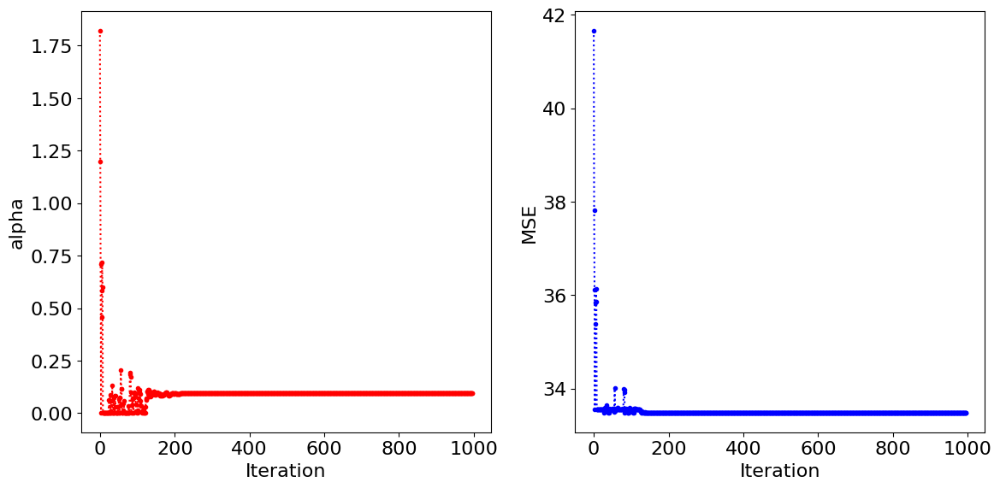

CPU times: user 36.7 s, sys: 220 ms, total: 37 s
Wall time: 37.3 s


In [ ]:
%%time
model,states,costs = annealing()

lowest_cost, best_states = locate_min(costs)
print('Lowest cost function value: ' + str(lowest_cost))
print('Best alpha value(s):')
print([states[idx] for idx in best_states])

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.plot(states,':.r')
plt.xlabel('Iteration')
plt.ylabel('alpha')
plt.subplot(1,2,2)
plt.plot(costs,':.b')
plt.xlabel('Iteration')
plt.ylabel('MSE')
plt.tight_layout()
plt.show()

Text(0, 0.5, 'MSE')

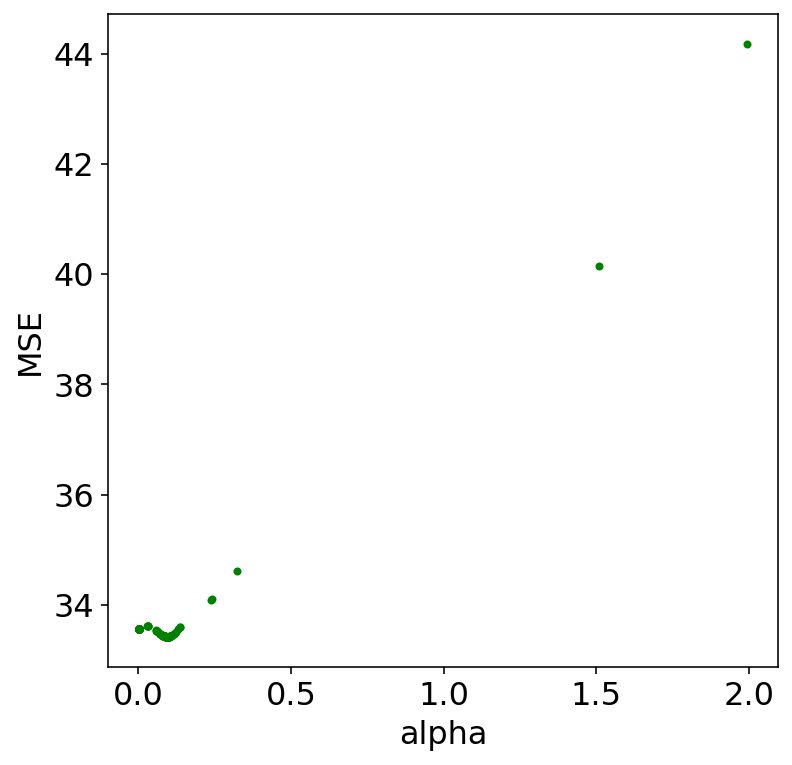

In [ ]:
plt.figure(figsize=(6,6))
plt.plot(states,costs,'.g')
plt.xlabel('alpha')
plt.ylabel('MSE')